#About Dataset
salaries dataset generally provides information about the employees of an organization in relation to their compensation. It typically includes details such as how much each employee is paid (their salary), their job titles, the departments they work in, and possibly additional information like their level of experience, education, and employment history within the organization.

# Features
- 'Id'
- 'EmployeeName'
- 'JobTitle'
- 'BasePay'
- 'OvertimePay'
- 'OtherPay'
- 'Benefits'
- 'TotalPay' -> salary
- 'TotalPayBenefits'
- 'Year'
- 'Notes'
- 'Agency'
- 'Status'


# Tasks

1. **Basic Data Exploration**: Identify the number of rows and columns in the dataset, determine the data types of each column, and check for missing values in each column.

2. **Descriptive Statistics**: Calculate basic statistics mean, median, mode, minimum, and maximum salary, determine the range of salaries, and find the standard deviation.

3. **Data Cleaning**: Handle missing data by suitable method with explain why you use it.

4. **Basic Data Visualization**: Create histograms or bar charts to visualize the distribution of salaries, and use pie charts to represent the proportion of employees in different departments.

5. **Grouped Analysis**: Group the data by one or more columns and calculate summary statistics for each group, and compare the average salaries across different groups.

6. **Simple Correlation Analysis**: Identify any correlation between salary and another numerical column, and plot a scatter plot to visualize the relationship.

8. **Summary of Insights**: Write a brief report summarizing the findings and insights from the analyses.

In [70]:
import pandas as pd
import numpy as np

# Load your dataset
df = pd.read_csv('Salaries.csv')
df.head()


,Id,EmployeeName,JobTitle,BasePay,OvertimePay,OtherPay,Benefits,TotalPay,TotalPayBenefits,Year,Notes,Agency,Status
0,1,NATHANIEL FORD,GENERAL MANAGER-METROPOLITAN TRANSIT AUTHORITY,167411.18,0.00,400184.25,NaN,567595.43,567595.43,2011,NaN,San Francisco,NaN
1,2,GARY JIMENEZ,CAPTAIN III (POLICE DEPARTMENT),155966.02,245131.88,137811.38,NaN,538909.28,538909.28,2011,NaN,San Francisco,NaN
2,3,ALBERT PARDINI,CAPTAIN III (POLICE DEPARTMENT),212739.13,106088.18,16452.60,NaN,335279.91,335279.91,2011,NaN,San Francisco,NaN
3,4,CHRISTOPHER CHONG,WIRE ROPE CABLE MAINTENANCE MECHANIC,77916.00,56120.71,198306.90,NaN,332343.61,332343.61,2011,NaN,San Francisco,NaN
4,5,PATRICK GARDNER,"DEPUTY CHIEF OF DEPARTMENT,(FIRE DEPARTMENT)",134401.60,9737.00,182234.59,NaN,326373.19,326373.19,2011,NaN,San Francisco,NaN


In [71]:
df.columns

Index(['Id', 'EmployeeName', 'JobTitle', 'BasePay', 'OvertimePay', 'OtherPay',
       'Benefits', 'TotalPay', 'TotalPayBenefits', 'Year', 'Notes', 'Agency',
       'Status'],
      dtype='object')

**Basic Data Exploration**: Identifing the number of rows and columns in the dataset.

In [72]:
rows = df.shape[0]
columns = df.shape[1]
print(f"Number of rows is {rows}")
print(f"Number of columns is {columns}")

Number of rows is 148654
Number of columns is 13


**Basic Data Exploration:** Determining the data types of each column, and checking for missing values in each column.

In [73]:
data_types = df.dtypes

print(f"Data types are : {data_types}" )

Data types are : Id                    int64
EmployeeName         object
JobTitle             object
BasePay             float64
OvertimePay         float64
OtherPay            float64
Benefits            float64
TotalPay            float64
TotalPayBenefits    float64
Year                  int64
Notes               float64
Agency               object
Status              float64
dtype: object


In [74]:
missing_values = df.isnull().sum()

print(f"Data types are : {missing_values}" )

Data types are : Id                       0
EmployeeName             0
JobTitle                 0
BasePay                609
OvertimePay              4
OtherPay                 4
Benefits             36163
TotalPay                 0
TotalPayBenefits         0
Year                     0
Notes               148654
Agency                   0
Status              148654
dtype: int64


In [75]:
df_copy = df.copy()

**Descriptive Statistics**: Calculating basic statistics mean, median, mode, minimum, and maximum salary, determining the range of salaries, and finding the standard deviation.

In [76]:
salaries_mean = round(df_copy['TotalPay'].mean() , 2 )
salaries_median = round( df_copy['TotalPay'].median() , 2 )
salaries_mode = df_copy['TotalPay'].mode().iloc[0]
salaries_min = df_copy['TotalPay'].min()
salaries_max = df_copy['TotalPay'].max()
salary_range = [salaries_min , salaries_max]
salaries_standard_deviation = round( df_copy['TotalPay'].std() , 2 )

print(f"Mean of salaries: {salaries_mean}")
print(f"Median of Salaries: {salaries_median}")
print(f"Mode of Salaries: {salaries_mode}")
print(f"Minimum Salary: {salaries_min}")
print(f"Maximum Salary: {salaries_max}")
print(f"Salary Range: from {salary_range[0]} to {salary_range[1]}")
print(f"Standard Deviation of Salary: {salaries_standard_deviation}")


Mean of salaries: 74768.32
Median of Salaries: 71426.61
Mode of Salaries: 0.0
Minimum Salary: -618.13
Maximum Salary: 567595.43
Salary Range: from -618.13 to 567595.43
Standard Deviation of Salary: 50517.01


Exploring why we got zero mode && negative minmum salary

In [77]:
df_copy['TotalPay'].value_counts().sort_index()

TotalPay
-618.13         1
 0.00         368
 0.30           1
 1.77           1
 1.83           1
             ... 
 362844.66      1
 390111.98      1
 471952.64      1
 538909.28      1
 567595.43      1
Name: count, Length: 138486, dtype: int64

**Data Cleaning:**
Clean Zero and negative Salaries

In [78]:
df_copy = df_copy[ (df_copy['TotalPay'] > 0) & (df_copy["BasePay"] >= 0) &( df_copy["OvertimePay"] >= 0) ]
salaries_mean = round(df_copy['TotalPay'].mean() , 2 )
salaries_median = round( df_copy['TotalPay'].median() , 2 )
salaries_mode = df_copy['TotalPay'].mode().iloc[0]
salaries_min = df_copy['TotalPay'].min()
salaries_max = df_copy['TotalPay'].max()
salary_range = [salaries_min , salaries_max]
salaries_standard_deviation = round( df_copy['TotalPay'].std() , 2 )

print(f"Mean of salaries: {salaries_mean}")
print(f"Median of Salaries: {salaries_median}")
print(f"Mode of Salaries: {salaries_mode}")
print(f"Minimum Salary: {salaries_min}")
print(f"Maximum Salary: {salaries_max}")
print(f"Salary Range: from {salary_range[0]} to {salary_range[1]}")
print(f"Standard Deviation of Salary: {salaries_standard_deviation}")
print(f"New Length is {df_copy.shape}")

Mean of salaries: 75102.48
Median of Salaries: 71669.25
Mode of Salaries: 18594.0
Minimum Salary: 0.3
Maximum Salary: 567595.43
Salary Range: from 0.3 to 567595.43
Standard Deviation of Salary: 50391.66
New Length is (147956, 13)


**Data Cleaning**: Handle missing data by Dropping method because Status and Notes has NaN values equal to size of Data_Set so dropped, also deleting non important columns, deleting Agency because it has zero information gain.

In [79]:
df_copy.drop(columns=['Status', 'Notes','Id','Agency'], inplace=True)

Cleaning and renaming some non-clean columns

In [80]:
df_copy['JobTitle'] = df_copy['JobTitle'].replace('POLICE OFFICER III', 'POLICE OFFICER 3')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Police Officer 3', 'POLICE OFFICER 3')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('X-Ray Laboratory Aide', 'X-RAY LABORATORY AIDE')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('BOARD COMMISSION MEMBER, $200 PER MEETING', 'BOARD COMMISSION MEMBER')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Battlion Chief, Fire Suppressi', 'Battalion Chief, Fire Suppress')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('BdComm Mbr, Grp2,M=$25/Mtg', 'BdComm Mbr')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('BdComm Mbr, Grp3,M=$50/Mtg', 'BdComm Mbr')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('BdComm Mbr, Grp5,M$100/Mo', 'BdComm Mbr')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Brd Comm Mbr, M=$200/Mtg', 'Brd Comm Mbr')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Biologist', 'Biologist I/II')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Chef', 'CHEF')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Chemist', 'Chemist I/II')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Commissioner No Benefits', 'Commissioner')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Commissioner 16.700c, No Pay', 'Commissioner')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Counselor, Family Court Svc', 'Counselor')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Counselor, Juvenile Hall', 'Counselor')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Counselor, Juvenile Hall SFERS', 'Counselor')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Counselor, Log Cabin Ranch', 'Counselor')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Counselor, Juvenile Hall SFERS', 'Counselor')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('Counselor,Log Cabin Rnch SFERS', 'Counselor')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('MANAGER VIII - MUNICIPAL TRANSPORTATION AGENCY', 'MANAGER VIII')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('SENIOR STATIONARY ENGINEER, SEWAGE PLANT', 'SENIOR STATIONARY ENGINEER')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('SENIOR STATIONARY ENGINEER, WATER TREATMENT PLANT', 'SENIOR STATIONARY ENGINEER')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('SENIOR STATIONARY ENGINEER, WATER TREATMENT PLANT', 'SENIOR STATIONARY ENGINEER')
df_copy['JobTitle'] = df_copy['JobTitle'].replace('SENIOR STATIONARY ENGINEER, WATER TREATMENT PLANT', 'SENIOR STATIONARY ENGINEER')


i = 50 
j = 100
# i = i + 50
#j = j + 50
df_sorted = df_copy['JobTitle'].value_counts().sort_index().iloc[i-1:j+1]
print(df_sorted," from ",i,"to ",j)

JobTitle
ASPHALT WORKER                                         26
ASR Senior Office Specialist                           60
ASR-Office Assistant                                   41
ASSESSMENT CLERK                                       36
ASSESSOR                                                1
ASSISTANT CHIEF ATTORNEY I                             23
ASSISTANT CHIEF ATTORNEY II                             5
ASSISTANT CHIEF DISTRICT ATTORNEY'S INVESTIGATOR        4
ASSISTANT CHIEF OF DEPARTMENT, (FIRE DEPARTMENT)        3
ASSISTANT CHIEF VICTIM/WITNESS INVESTIGATOR             5
ASSISTANT CLERK, BOARD OF SUPERVISORS                   5
ASSISTANT CONSTRUCTION INSPECTOR                        7
ASSISTANT COOK                                          6
ASSISTANT COUNSELOR                                     4
ASSISTANT COURT REPORTER COORDINATOR                    1
ASSISTANT DEPUTY CHIEF II                               5
ASSISTANT DEPUTY DIRECTOR, PORT                         2
ASSIS

**Data Cleaning:** Capitalizing all values to avoid repeating values

In [81]:
df_copy['JobTitle'] = df_copy['JobTitle'].str.upper()
df_copy['EmployeeName'] = df_copy['EmployeeName'].str.upper()

**Basic Data Visualization**: Creating histograms to visualize the distribution of salaries.

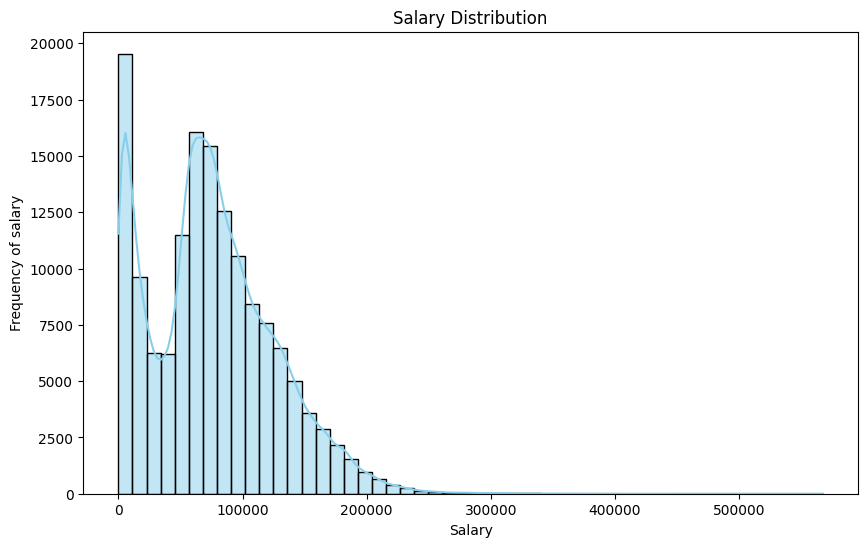

In [82]:
import matplotlib.pyplot as plt
import seaborn as sns

# Histogram for Salary Distribution
plt.figure(figsize=(10, 6))
sns.histplot(df_copy['TotalPay'], bins=50, kde=True, color='skyblue')
plt.title('Salary Distribution')
plt.xlabel('Salary')
plt.ylabel('Frequency of salary')
plt.show()

Using pie chart to represent the proportion of employees in different departments.

In [83]:
department_counts = df_copy['JobTitle'].value_counts()
plt.figure(figsize=(100,100))
plt.pie(department_counts, labels=department_counts.index, autopct='%1.1f%%', startangle=90, colors=sns.color_palette('pastel'))
plt.title('Proportion of Employees in Different Departments')
plt.show()

Most informative are first 30 pie slice.

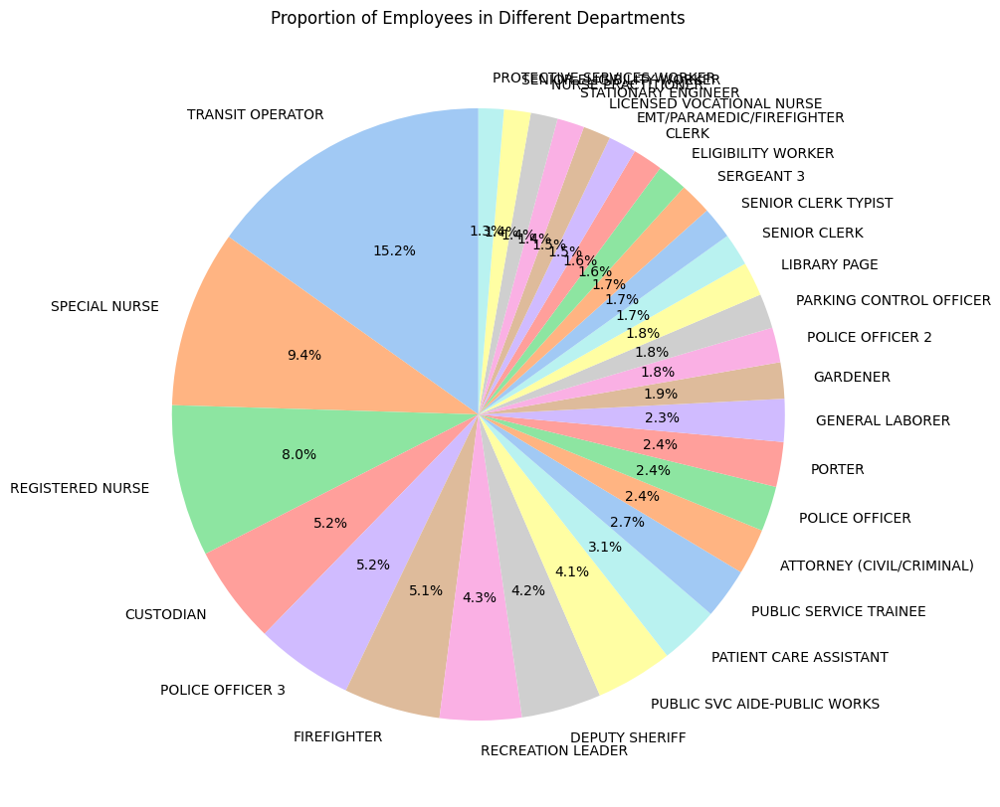

In [87]:
department_counts = df_copy['JobTitle'].value_counts().head(30)
plt.figure(figsize=(10,10))
plt.pie(department_counts, labels=department_counts.index, autopct='%1.1f%%', startangle=90, colors=sns.color_palette('pastel'))
plt.title('Proportion of Employees in Different Departments')
plt.show()

**Grouped Analysis**: Grouping data by one or more columns and calculating summary statistics for each group, and comparing the average salaries across different groups.

In [88]:
grouped_df = df_copy.groupby('JobTitle')['TotalPay'].agg(['count', 'mean', 'median', 'min', 'max', 'std']).reset_index()

print(grouped_df)

                                            JobTitle  count          mean  \
0                                      ACCOUNT CLERK    347  43482.953573   
1                                         ACCOUNTANT      5  47429.268000   
2                                       ACCOUNTANT I      8  62036.101250   
3                                      ACCOUNTANT II    226  67355.202699   
4                                     ACCOUNTANT III    276  79550.215326   
...                                              ...    ...           ...   
1614              WORKER'S COMPENSATION SUPERVISOR I      5  91020.726000   
1615                           X-RAY LABORATORY AIDE    126  51212.279048   
1616                              YOUTH COMM ADVISOR      4  41414.307500   
1617  YOUTH COMMISSION ADVISOR, BOARD OF SUPERVISORS      1  53632.870000   
1618                                     ZOO CURATOR      1  66686.560000   

         median       min        max           std  
0     50401.800    237

In [89]:
grouped_df_2 = df_copy.groupby('JobTitle')['BasePay'].describe()

print(grouped_df_2)

                                                count          mean  \
JobTitle                                                              
ACCOUNT CLERK                                   347.0  42716.716081   
ACCOUNTANT                                        5.0  46643.172000   
ACCOUNTANT I                                      8.0  61777.832500   
ACCOUNTANT II                                   226.0  66880.084425   
ACCOUNTANT III                                  276.0  78940.945000   
...                                               ...           ...   
WORKER'S COMPENSATION SUPERVISOR I                5.0  90966.140000   
X-RAY LABORATORY AIDE                           126.0  46412.085794   
YOUTH COMM ADVISOR                                4.0  39077.957500   
YOUTH COMMISSION ADVISOR, BOARD OF SUPERVISORS    1.0  52609.910000   
ZOO CURATOR                                       1.0  43148.000000   

                                                         std       min  \
Jo

In [90]:
grouped_data3 = df_copy.groupby(['EmployeeName', 'Year']).agg({
    'BasePay': 'mean',
    'OvertimePay': 'mean',
    'OtherPay': 'mean',
    'TotalPay': 'mean',
    'TotalPayBenefits': 'mean'
}).sort_values(by='TotalPay')
print(grouped_data3)

                       BasePay  OvertimePay   OtherPay   TotalPay  \
EmployeeName   Year                                                 
JOE BROWN JR   2011       0.00         0.00       0.30       0.30   
DONALD CLARK   2012       0.00         0.00       1.77       1.77   
SYLVIA R JONES 2014       0.00         0.00       1.83       1.83   
SERENA HUGHES  2011       0.00         0.00       4.17       4.17   
ROCK CRAWFORD  2011       0.00         0.00       5.80       5.80   
...                        ...          ...        ...        ...   
GARY ALTENBERG 2012  128808.87    220909.48   13126.31  362844.66   
AMY P HART     2014  318835.49     10712.95   60563.54  390111.98   
DAVID SHINN    2014  129150.01         0.00  342802.63  471952.64   
GARY JIMENEZ   2011  155966.02    245131.88  137811.38  538909.28   
NATHANIEL FORD 2011  167411.18         0.00  400184.25  567595.43   

                     TotalPayBenefits  
EmployeeName   Year                    
JOE BROWN JR   2011   

In [91]:
df_copy.columns

Index(['EmployeeName', 'JobTitle', 'BasePay', 'OvertimePay', 'OtherPay',
       'Benefits', 'TotalPay', 'TotalPayBenefits', 'Year'],
      dtype='object')

**Simple Correlation Analysis**: Identifing any correlation between salary and another numerical column, and plot a scatter plot to visualize the relationship.

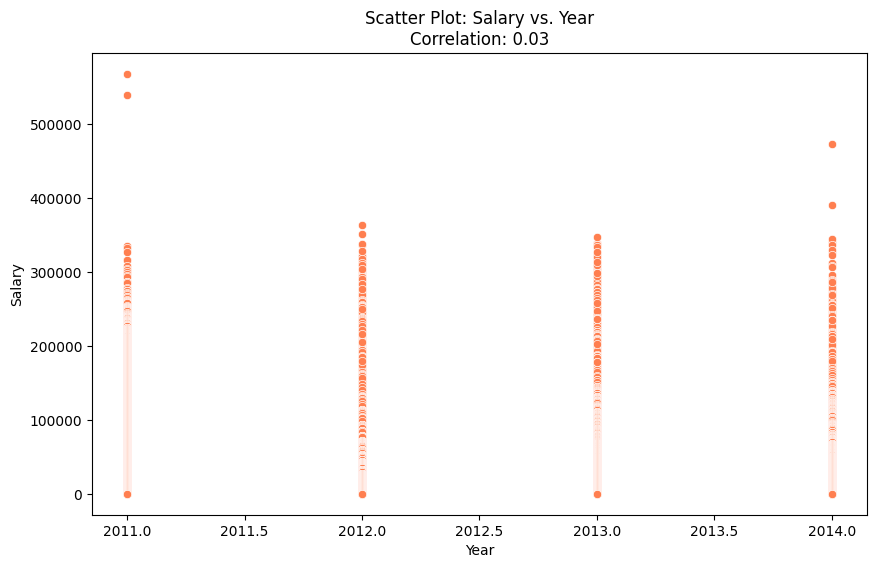

In [92]:
import matplotlib.pyplot as plt
import seaborn as sns

correlation = df['TotalPay'].corr(df['Year'])

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Year', y='TotalPay', data=df_copy, color='coral')
plt.title(f'Scatter Plot: Salary vs. Year\nCorrelation: {correlation:.2f}')
plt.xlabel('Year')
plt.ylabel('Salary')
plt.show()

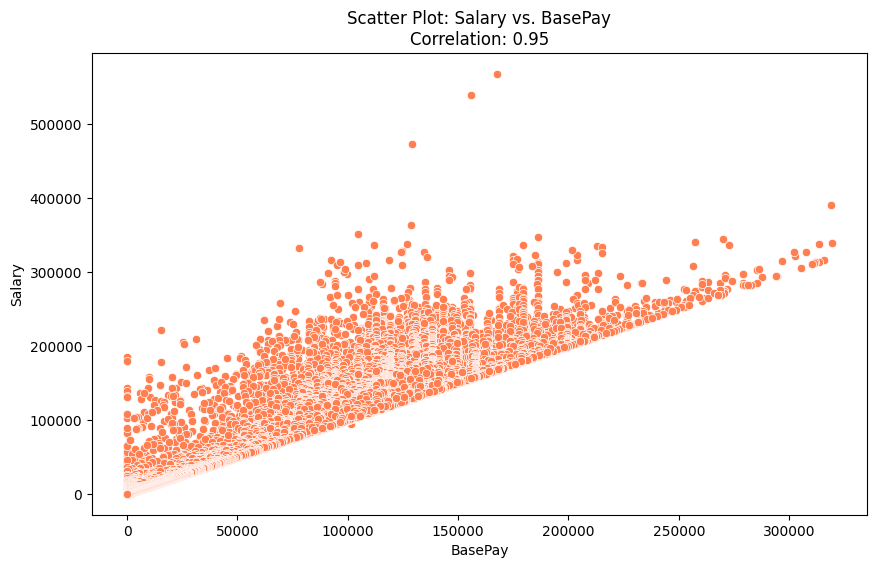

In [93]:
import matplotlib.pyplot as plt
import seaborn as sns

correlation = df['TotalPay'].corr(df['BasePay'])

plt.figure(figsize=(10, 6))
sns.scatterplot(x='BasePay', y='TotalPay', data=df_copy, color='coral')
plt.title(f'Scatter Plot: Salary vs. BasePay\nCorrelation: {correlation:.2f}')
plt.xlabel('BasePay')
plt.ylabel('Salary')
plt.show()

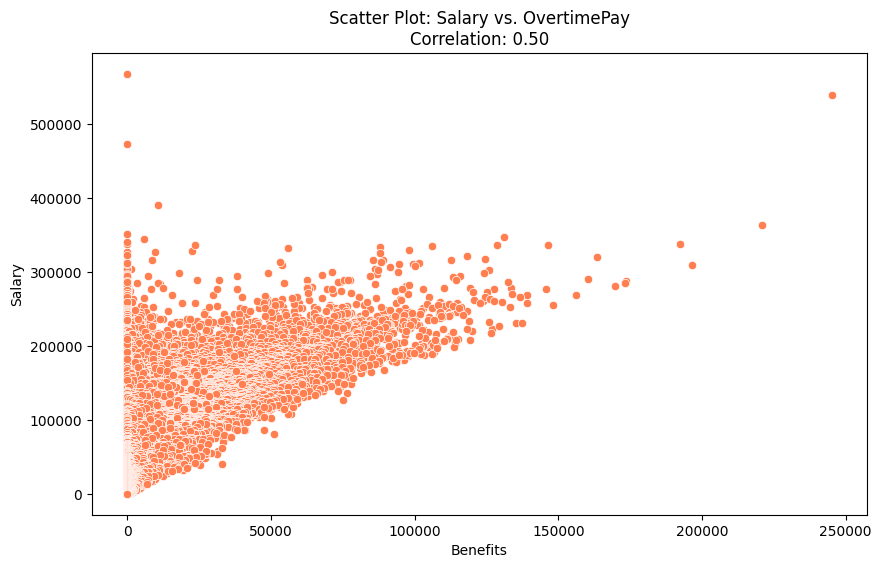

In [94]:
import matplotlib.pyplot as plt
import seaborn as sns

correlation = df['TotalPay'].corr(df['OvertimePay'])

plt.figure(figsize=(10, 6))
sns.scatterplot(x='OvertimePay', y='TotalPay', data=df_copy, color='coral')
plt.title(f'Scatter Plot: Salary vs. OvertimePay\nCorrelation: {correlation:.2f}')
plt.xlabel('Benefits')
plt.ylabel('Salary')
plt.show()

**Saving Enhanced Dataframe**

In [95]:
csv_path = 'Salaries_enhanced.csv'

df_copy.to_csv(csv_path, index=False)

print(f"The Clean and Enhanced DataFrame has been exported to '{csv_path}'.")

The Clean and Enhanced DataFrame has been exported to 'Salaries_enhanced.csv'.


# Key Findings

**Cleaning Data**

**1. `Typo Errors` in some Columns(`Upper` and `Lower` letters, `Latin Numbers` and `English numbers`, salary included in role,...etc)**

**2. Non-sense TotalPay of `Zero` and `Negative` values in salaries**

**3. `Status` and `Agency` Does not contain any values so deleted and Agency is always San Francissco so no point of having it**


# Descriptive Statistics:

**Correlation Statistics:** Salary is `barely changing over years` so no strong inflation within company of increase in expenses.

**Statistical Analysis:** Salaries are between `{ 0 : 150000 } $` mostly.

**Statistical Analysis:** Top paid Titles are Transit operator `Transportation`, nurses `Medical Department` and police officers `Police department`.







# Recommendations:
1. Lowerize police depatments expenses by increasing `digital monitoring & defense` systems.

2. `Digitalize transit` operations.

3. `Digitalize parking` systems with IoT auto parking lots.
